In [ ]:
from google.colab import drive
drive.mount('/content/drive')
!cp -av 'drive/My Drive/Colab Notebooks/GANs' '/content'
%cd GANs

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
'drive/My Drive/Colab Notebooks/GANs/download_cat.sh' -> '/content/GANs/download_cat.sh'
'drive/My Drive/Colab Notebooks/GANs/gan/utils.py' -> '/content/GANs/gan/utils.py'
'drive/My Drive/Colab Notebooks/GANs/gan/spectral_normalization.py' -> '/content/GANs/gan/spectral_normalization.py'
'drive/My Drive/Colab Notebooks/GANs/gan/.ipynb_checkpoints/train-checkpoint.py' -> '/content/GANs/gan/.ipynb_checkpoints/train-checkpoint.py'
'drive/My Drive/Colab Notebooks/GANs/gan/.ipynb_checkpoints/utils-checkpoint.py' -> '/content/GANs/gan/.ipynb_checkpoints/utils-checkpoint.py'
'drive/My Drive/Colab Notebooks/GANs/gan/__pycache__/utils.cpython-38.pyc' -> '/content/GANs/gan/__pycache__/utils.cpython-38.pyc'
'drive/My Drive/Colab Notebooks/GANs/gan/__pycache__/losses.cpython-38.pyc' -> '/content/GANs/gan/__pycache__/losses.cpython-38.pyc'
'drive/My Drive/Colab Notebooks/

In [ ]:
# !sh download_cat.sh

# Generative Adversarial Networks

For this part of the assignment you implement two different types of generative adversarial networks. We will train the networks on a dataset of cat face images.

In [ ]:
import torch
from torch.utils.data import DataLoader
from torchvision import transforms
from torchvision.datasets import ImageFolder
import matplotlib.pyplot as plt
import numpy as np

%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

%load_ext autoreload
%autoreload 2

In [ ]:
from gan.train import train

In [ ]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "gpu")

# GAN loss functions

In this assignment you will implement two different types of GAN cost functions. You will first implement the loss from the [original GAN paper](https://arxiv.org/pdf/1406.2661.pdf). You will also implement the loss from [LS-GAN](https://arxiv.org/abs/1611.04076). 

### GAN loss

**TODO:** Implement the `discriminator_loss` and `generator_loss` functions in `gan/losses.py`.

The generator loss is given by:
$$\ell_G  =  -\mathbb{E}_{z \sim p(z)}\left[\log D(G(z))\right]$$
and the discriminator loss is:
$$ \ell_D = -\mathbb{E}_{x \sim p_\text{data}}\left[\log D(x)\right] - \mathbb{E}_{z \sim p(z)}\left[\log \left(1-D(G(z))\right)\right]$$
Note that these are negated from the equations presented earlier as we will be *minimizing* these losses.

**HINTS**: You should use the `torch.nn.functional.binary_cross_entropy_with_logits` function to compute the binary cross entropy loss since it is more numerically stable than using a softmax followed by BCE loss. The BCE loss is needed to compute the log probability of the true label given the logits output from the discriminator. Given a score $s\in\mathbb{R}$ and a label $y\in\{0, 1\}$, the binary cross entropy loss is

$$ bce(s, y) = -y * \log(s) - (1 - y) * \log(1 - s) $$


Instead of computing the expectation of $\log D(G(z))$, $\log D(x)$ and $\log \left(1-D(G(z))\right)$, we will be averaging over elements of the minibatch, so make sure to combine the loss by averaging instead of summing.

In [ ]:
from gan.losses import discriminator_loss, generator_loss

### Least Squares GAN loss

**TODO:** Implement the `ls_discriminator_loss` and `ls_generator_loss` functions in `gan/losses.py`.

We'll now look at [Least Squares GAN](https://arxiv.org/abs/1611.04076), a newer, more stable alernative to the original GAN loss function. For this part, all we have to do is change the loss function and retrain the model. We'll implement equation (9) in the paper, with the generator loss:
$$\ell_G  =  \frac{1}{2}\mathbb{E}_{z \sim p(z)}\left[\left(D(G(z))-1\right)^2\right]$$
and the discriminator loss:
$$ \ell_D = \frac{1}{2}\mathbb{E}_{x \sim p_\text{data}}\left[\left(D(x)-1\right)^2\right] + \frac{1}{2}\mathbb{E}_{z \sim p(z)}\left[ \left(D(G(z))\right)^2\right]$$


**HINTS**: Instead of computing the expectation, we will be averaging over elements of the minibatch, so make sure to combine the loss by averaging instead of summing. When plugging in for $D(x)$ and $D(G(z))$ use the direct output from the discriminator (`scores_real` and `scores_fake`).

In [ ]:
from gan.losses import ls_discriminator_loss, ls_generator_loss

# GAN model architecture

**TODO:** Implement the `Discriminator` and `Generator` networks in `gan/models.py`.

We recommend the following architectures which are inspired by [DCGAN](https://arxiv.org/pdf/1511.06434.pdf):

**Discriminator:**

- convolutional layer with in_channels=3, out_channels=128, kernel=4, stride=2
- convolutional layer with in_channels=128, out_channels=256, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=256, out_channels=512, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=512, out_channels=1024, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=1024, out_channels=1, kernel=4, stride=1

Use padding = 1 (not 0) for all the convolutional layers.

Instead of Relu we LeakyReLu throughout the discriminator (we use a negative slope value of 0.2). You can use simply use relu as well.

The output of your discriminator should be a single value score corresponding to each input sample. See `torch.nn.LeakyReLU`.


**Generator:**

**Note:** In the generator, you will need to use transposed convolution (sometimes known as fractionally-strided convolution or deconvolution). This function is implemented in pytorch as `torch.nn.ConvTranspose2d`.

- transpose convolution with in_channels=NOISE_DIM, out_channels=1024, kernel=4, stride=1
- batch norm
- transpose convolution with in_channels=1024, out_channels=512, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=512, out_channels=256, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=256, out_channels=128, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=128, out_channels=3, kernel=4, stride=2

The output of the final layer of the generator network should have a `tanh` nonlinearity to output values between -1 and 1. The output should be a 3x64x64 tensor for each sample (equal dimensions to the images from the dataset).





In [ ]:
from gan.models import Discriminator, Generator

# Data loading

The cat images we provide are RGB images with a resolution of 64x64. In order to prevent our discriminator from overfitting, we will need to perform some data augmentation.

**TODO:** Implement data augmentation by adding new transforms to the cell below. At the minimum, you should have a RandomCrop and a ColorJitter, but we encourage you to experiment with different augmentations to see how the performance of the GAN changes. See https://pytorch.org/vision/stable/transforms.html.


In [ ]:
batch_size = 32
imsize = 64
cat_root = './cats'

cat_train = ImageFolder(root=cat_root, transform=transforms.Compose([
  transforms.ToTensor(),
    
  # Example use of RandomCrop:
  transforms.Resize(int(1.15 * imsize)),
  transforms.RandomCrop(imsize),
]))

cat_loader_train = DataLoader(cat_train, batch_size=batch_size, drop_last=True)

### Visualize dataset

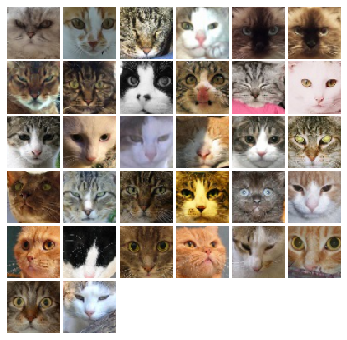

In [ ]:
from gan.utils import show_images

imgs = cat_loader_train.__iter__().next()[0].numpy().squeeze()
show_images(imgs, color=True)

# Training 


**TODO:** Fill in the training loop in `gan/train.py`.

In [ ]:
NOISE_DIM = 100
NUM_EPOCHS = 50
learning_rate = 0.001

### Train GAN

In [ ]:
D = Discriminator().to(device)
G = Generator(noise_dim=NOISE_DIM).to(device)

In [ ]:
D_optimizer = torch.optim.Adam(D.parameters(), lr=learning_rate, betas = (0.5, 0.999))
G_optimizer = torch.optim.Adam(G.parameters(), lr=learning_rate, betas = (0.5, 0.999))

EPOCH:  1
Iter: 0, D: 1.354, G:16.25


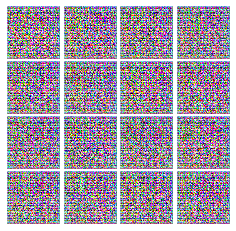


Iter: 250, D: 1.042, G:2.503


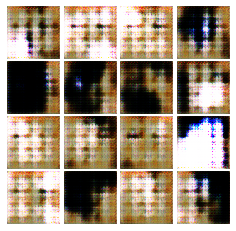


EPOCH:  2
Iter: 500, D: 1.576, G:2.103


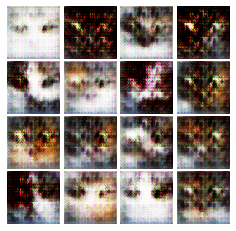


Iter: 750, D: 1.369, G:1.697


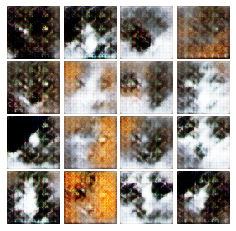


EPOCH:  3
Iter: 1000, D: 1.644, G:3.497


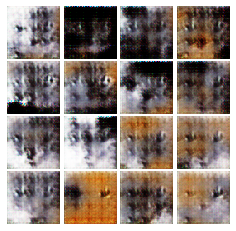


Iter: 1250, D: 1.468, G:1.728


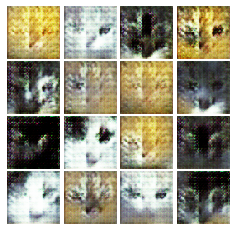


EPOCH:  4
Iter: 1500, D: 1.226, G:1.159


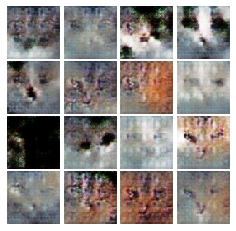


Iter: 1750, D: 1.28, G:2.575


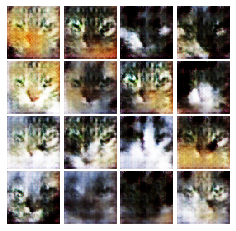


EPOCH:  5
Iter: 2000, D: 1.621, G:1.017


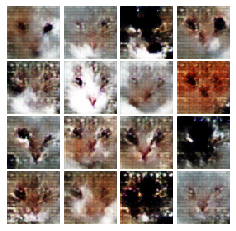


Iter: 2250, D: 0.7617, G:1.446


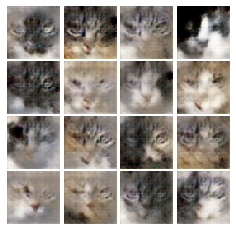


EPOCH:  6
Iter: 2500, D: 1.199, G:0.6817


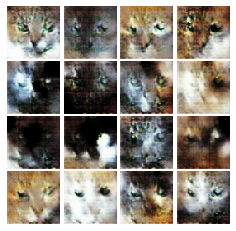


Iter: 2750, D: 1.006, G:1.923


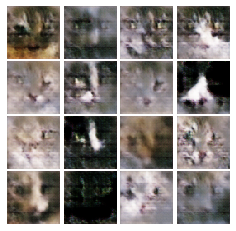


EPOCH:  7
Iter: 3000, D: 0.9751, G:1.586


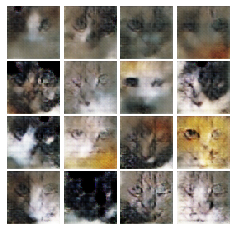


Iter: 3250, D: 1.098, G:2.184


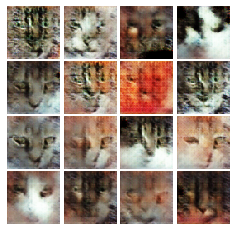


EPOCH:  8
Iter: 3500, D: 1.732, G:1.426


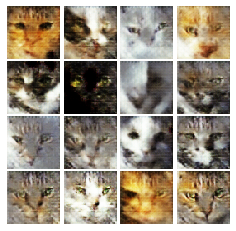


Iter: 3750, D: 0.7811, G:3.06


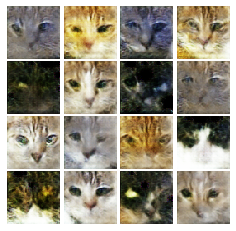


EPOCH:  9
Iter: 4000, D: 1.169, G:2.556


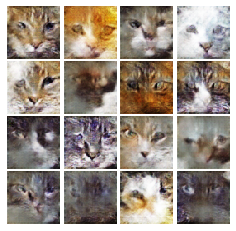


Iter: 4250, D: 1.016, G:1.803


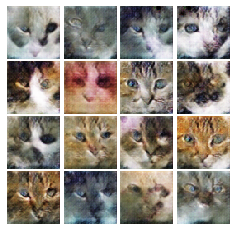


EPOCH:  10
Iter: 4500, D: 0.8376, G:3.317


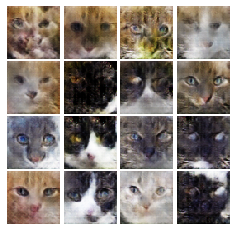


Iter: 4750, D: 0.8528, G:3.451


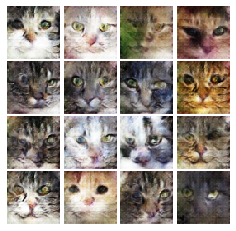


EPOCH:  11
Iter: 5000, D: 0.8779, G:2.702


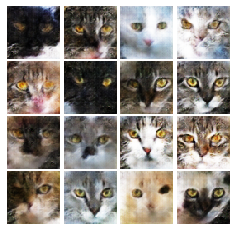


Iter: 5250, D: 0.8158, G:3.998


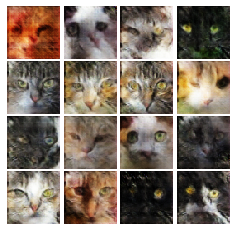


EPOCH:  12
Iter: 5500, D: 1.188, G:4.864


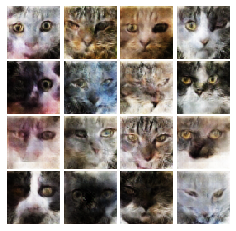


Iter: 5750, D: 0.6922, G:3.825


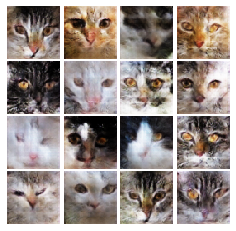


EPOCH:  13
Iter: 6000, D: 1.861, G:3.258


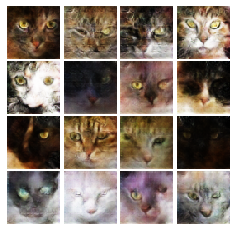


Iter: 6250, D: 1.067, G:4.788


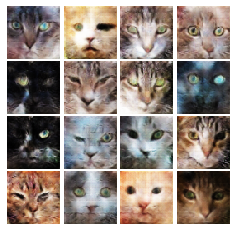


EPOCH:  14
Iter: 6500, D: 0.3392, G:4.229


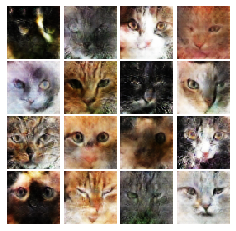


Iter: 6750, D: 0.6799, G:2.803


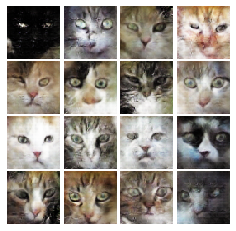


EPOCH:  15
Iter: 7000, D: 0.5912, G:4.218


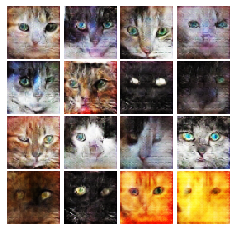


Iter: 7250, D: 0.7463, G:8.979


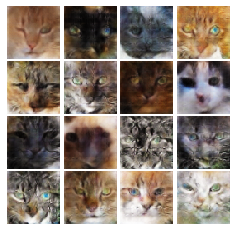


EPOCH:  16
Iter: 7500, D: 0.7239, G:2.414


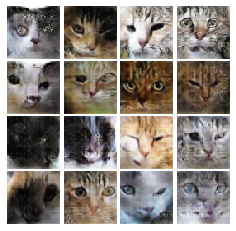


Iter: 7750, D: 0.2951, G:2.832


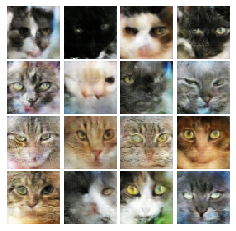


EPOCH:  17
Iter: 8000, D: 0.3564, G:5.051


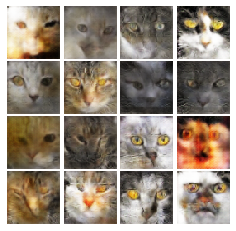


Iter: 8250, D: 0.1141, G:2.774


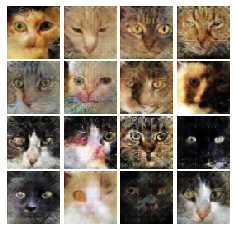


EPOCH:  18
Iter: 8500, D: 0.3346, G:4.216


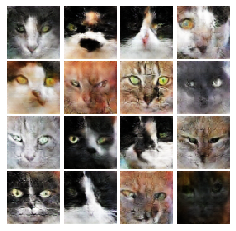


Iter: 8750, D: 0.3251, G:4.53


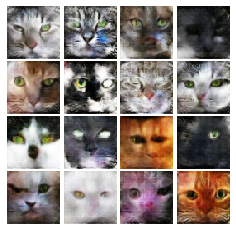


EPOCH:  19
Iter: 9000, D: 0.2238, G:4.03


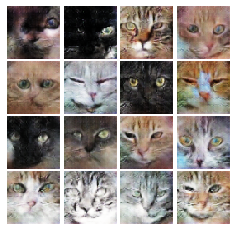


Iter: 9250, D: 0.9295, G:2.336


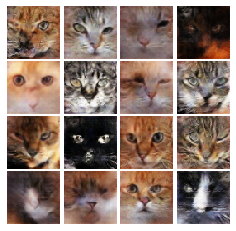


EPOCH:  20
Iter: 9500, D: 0.2443, G:3.586


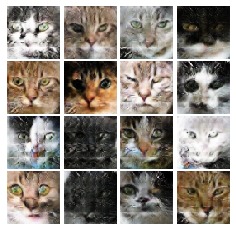


Iter: 9750, D: 0.5392, G:4.904


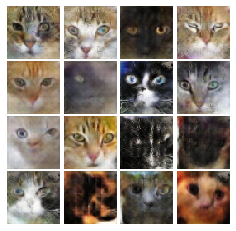


EPOCH:  21
Iter: 10000, D: 0.5795, G:3.791


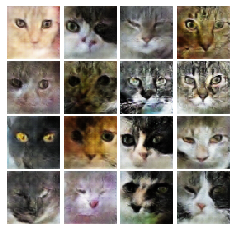


Iter: 10250, D: 0.2474, G:3.168


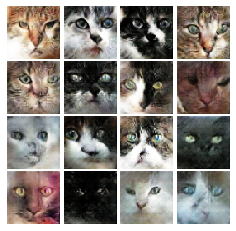


EPOCH:  22
Iter: 10500, D: 0.3577, G:6.855


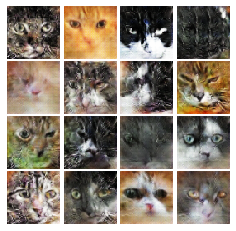


Iter: 10750, D: 0.8432, G:8.824


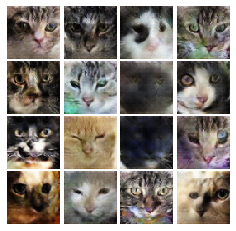


EPOCH:  23
Iter: 11000, D: 0.3237, G:5.213


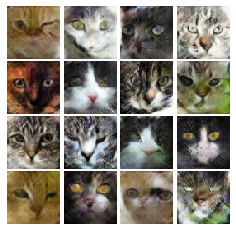


Iter: 11250, D: 0.2135, G:6.193


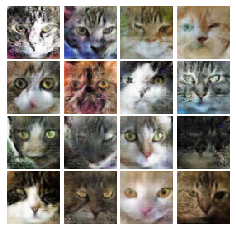


EPOCH:  24
Iter: 11500, D: 0.0772, G:3.867


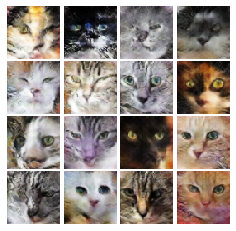


Iter: 11750, D: 0.1994, G:7.153


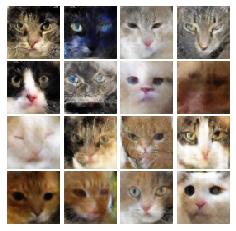


EPOCH:  25
Iter: 12000, D: 0.1905, G:7.392


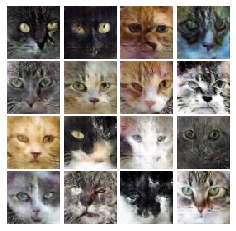


Iter: 12250, D: 0.03571, G:4.92


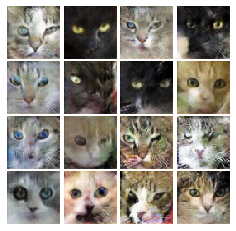


EPOCH:  26
Iter: 12500, D: 1.102, G:9.725


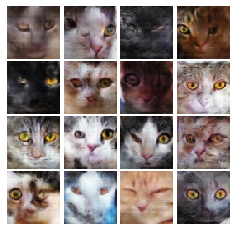


Iter: 12750, D: 0.2213, G:10.29


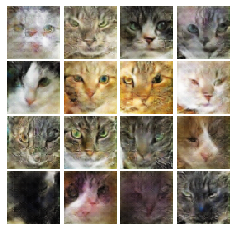


EPOCH:  27
Iter: 13000, D: 0.1676, G:6.285


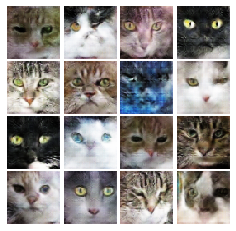


Iter: 13250, D: 0.1639, G:6.414


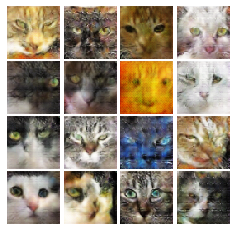


EPOCH:  28
Iter: 13500, D: 0.2289, G:4.331


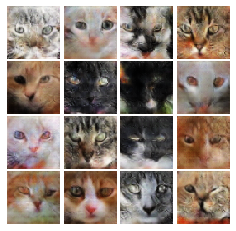


Iter: 13750, D: 0.09909, G:5.338


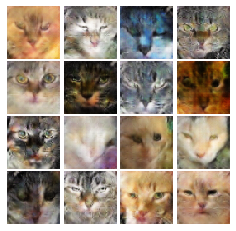


EPOCH:  29
Iter: 14000, D: 0.06276, G:4.163


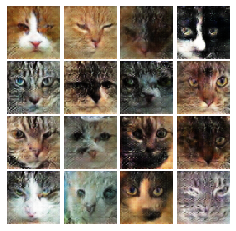


Iter: 14250, D: 0.07801, G:5.597


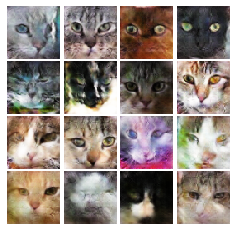


EPOCH:  30
Iter: 14500, D: 0.06527, G:7.302


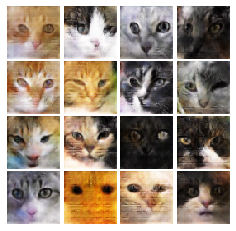


Iter: 14750, D: 0.1331, G:4.667


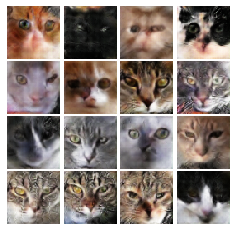


EPOCH:  31
Iter: 15000, D: 0.09349, G:4.78


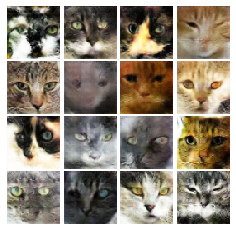


Iter: 15250, D: 0.1053, G:7.483


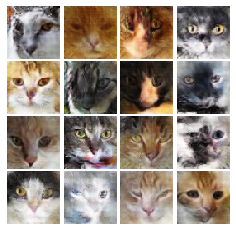


EPOCH:  32
Iter: 15500, D: 0.2128, G:4.449


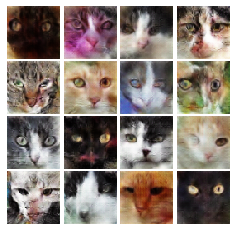


EPOCH:  33
Iter: 15750, D: 0.01179, G:4.369


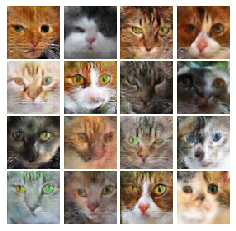


Iter: 16000, D: 0.1364, G:7.059


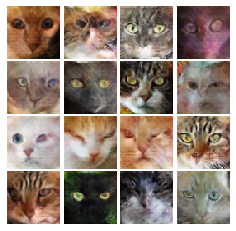


EPOCH:  34
Iter: 16250, D: 0.09619, G:4.816


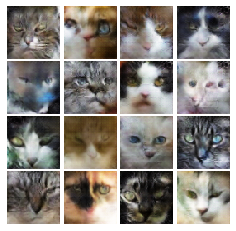


Iter: 16500, D: 0.5027, G:5.237


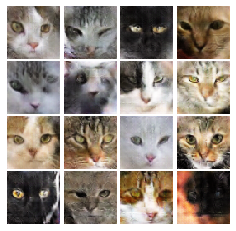


EPOCH:  35
Iter: 16750, D: 0.04964, G:6.147


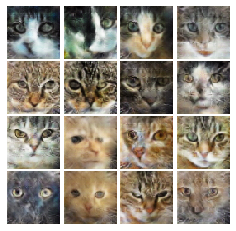


Iter: 17000, D: 0.5729, G:7.695


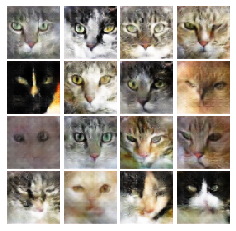


EPOCH:  36
Iter: 17250, D: 0.1143, G:7.203


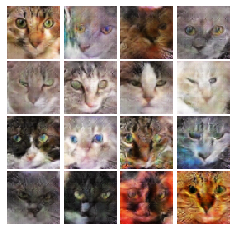


Iter: 17500, D: 0.5789, G:3.479


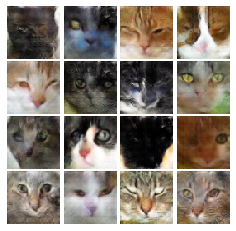


EPOCH:  37
Iter: 17750, D: 0.08654, G:4.795


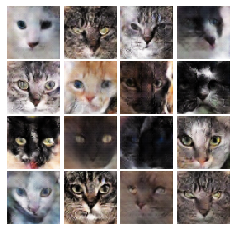


Iter: 18000, D: 0.8973, G:7.113


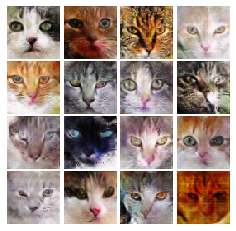


EPOCH:  38
Iter: 18250, D: 1.163, G:0.01837


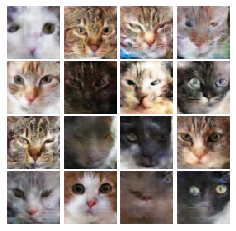


Iter: 18500, D: 3.419e-05, G:12.53


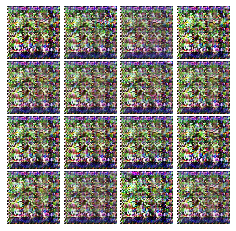


EPOCH:  39
Iter: 18750, D: 0.6901, G:9.875


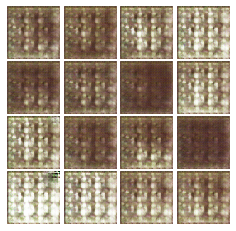


Iter: 19000, D: 0.03237, G:6.388


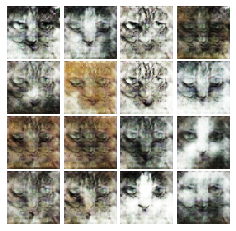


EPOCH:  40
Iter: 19250, D: 0.3276, G:7.986


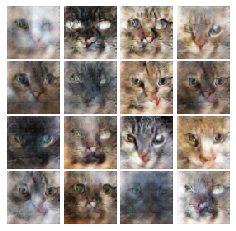


Iter: 19500, D: 0.06717, G:6.426


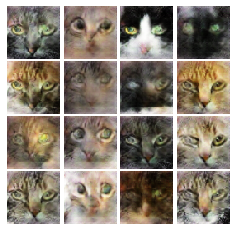


EPOCH:  41
Iter: 19750, D: 0.2209, G:4.067


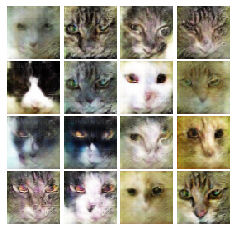


Iter: 20000, D: 0.05693, G:6.063


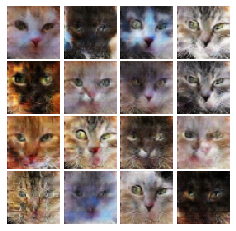


EPOCH:  42
Iter: 20250, D: 0.02885, G:8.612


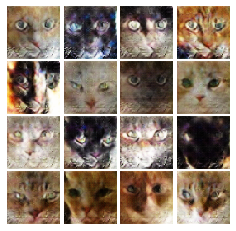


Iter: 20500, D: 1.966, G:13.04


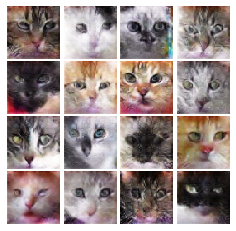


EPOCH:  43
Iter: 20750, D: 0.3193, G:3.702


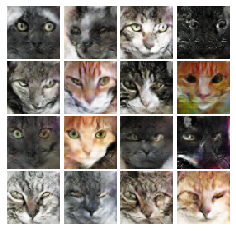


Iter: 21000, D: 0.2873, G:5.975


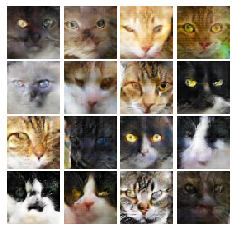


EPOCH:  44
Iter: 21250, D: 0.176, G:5.363


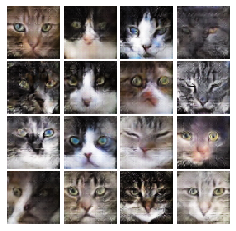


Iter: 21500, D: 0.1533, G:7.654


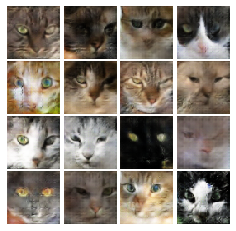


EPOCH:  45
Iter: 21750, D: 0.372, G:0.648


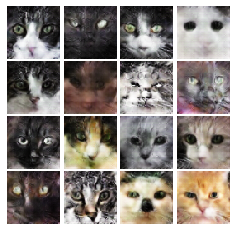


Iter: 22000, D: 0.1497, G:6.876


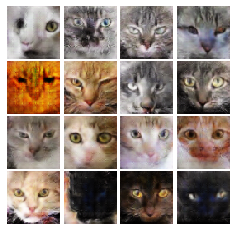


EPOCH:  46
Iter: 22250, D: 0.03797, G:7.172


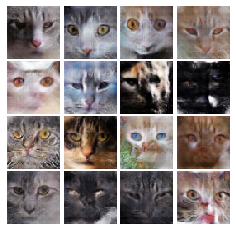


Iter: 22500, D: 0.01111, G:7.709


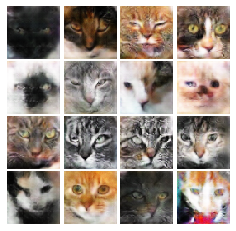


EPOCH:  47
Iter: 22750, D: 0.2594, G:4.875


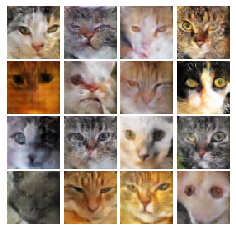


Iter: 23000, D: 0.001893, G:12.45


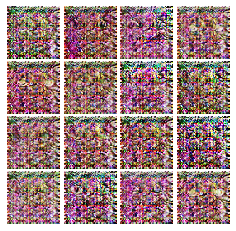


EPOCH:  48
Iter: 23250, D: 0.02787, G:6.662


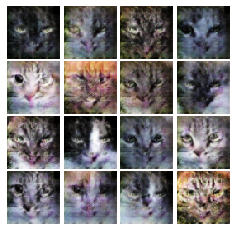


Iter: 23500, D: 0.06869, G:7.12


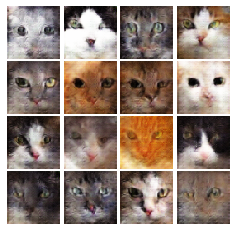


EPOCH:  49
Iter: 23750, D: 0.02803, G:7.972


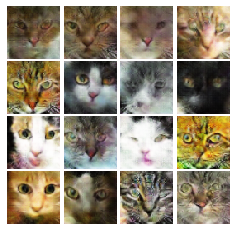


Iter: 24000, D: 0.01667, G:6.459


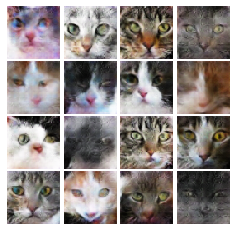


EPOCH:  50
Iter: 24250, D: 0.04858, G:7.739


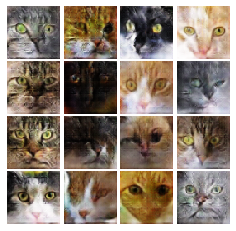


Iter: 24500, D: 1.127, G:3.23


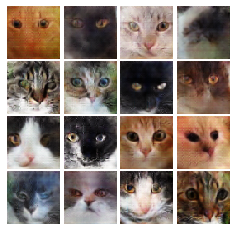

In [ ]:
# original gan
#  change the train() method a little bit to fit the input dimension. noise_size
train(D, G, D_optimizer, G_optimizer, discriminator_loss, 
          generator_loss, num_epochs=NUM_EPOCHS, show_every=250,
          batch_size=batch_size, train_loader=cat_loader_train, device=device)


### Train LS-GAN

In [ ]:
D = Discriminator().to(device)
G = Generator(noise_dim=NOISE_DIM).to(device)

In [ ]:
D_optimizer = torch.optim.Adam(D.parameters(), lr=learning_rate, betas = (0.5, 0.999))
G_optimizer = torch.optim.Adam(G.parameters(), lr=learning_rate, betas = (0.5, 0.999))

EPOCH:  1
Iter: 0, D: 0.7231, G:220.1


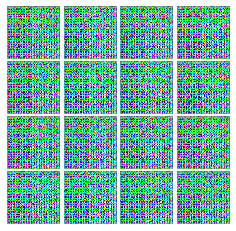


Iter: 250, D: 0.3931, G:0.4904


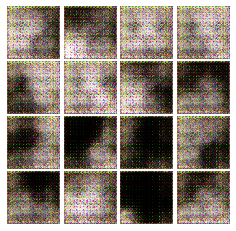


EPOCH:  2
Iter: 500, D: 0.4305, G:0.3397


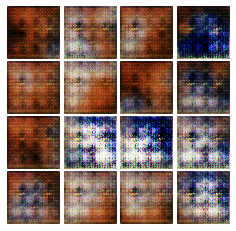


Iter: 750, D: 0.09824, G:0.5776


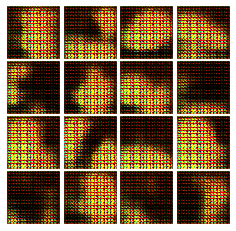


EPOCH:  3
Iter: 1000, D: 0.03439, G:0.522


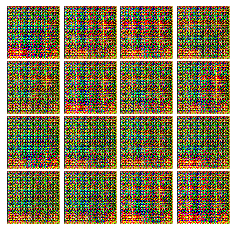


Iter: 1250, D: 0.07153, G:0.413


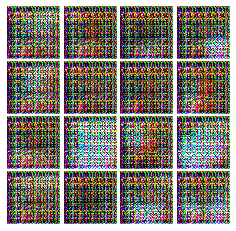


EPOCH:  4
Iter: 1500, D: 0.01027, G:0.4075


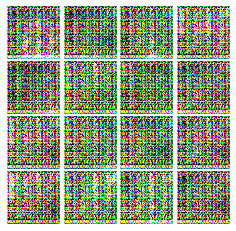


Iter: 1750, D: 1.585, G:1.619


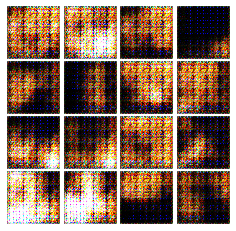


EPOCH:  5
Iter: 2000, D: 0.2941, G:0.07328


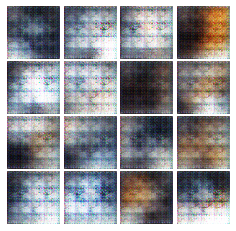


Iter: 2250, D: 0.1147, G:0.6202


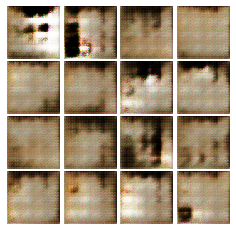


EPOCH:  6
Iter: 2500, D: 0.2057, G:0.1509


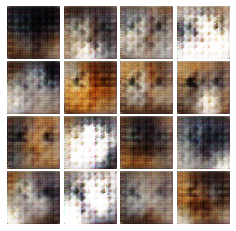


Iter: 2750, D: 0.139, G:0.4469


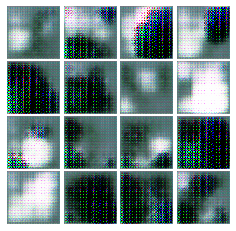


EPOCH:  7
Iter: 3000, D: 0.1986, G:0.3503


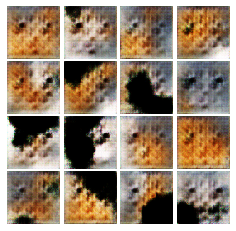


Iter: 3250, D: 0.2201, G:0.3667


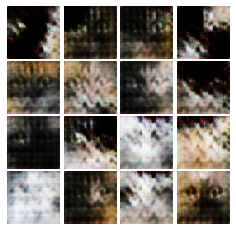


EPOCH:  8
Iter: 3500, D: 0.2787, G:0.3026


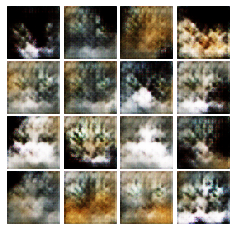


Iter: 3750, D: 0.1811, G:0.199


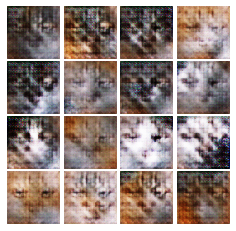


EPOCH:  9
Iter: 4000, D: 0.2533, G:0.2354


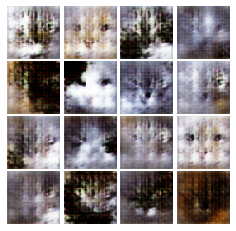


Iter: 4250, D: 0.3842, G:0.2972


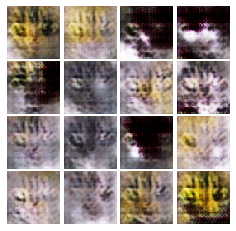


EPOCH:  10
Iter: 4500, D: 0.2682, G:0.2908


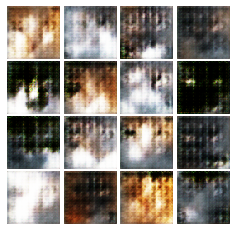


Iter: 4750, D: 0.2919, G:0.2791


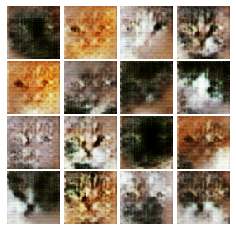


EPOCH:  11
Iter: 5000, D: 0.3344, G:0.4204


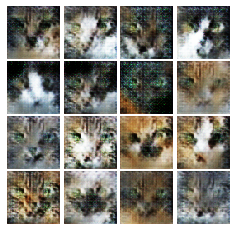


Iter: 5250, D: 0.2536, G:0.6228


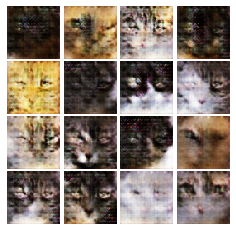


EPOCH:  12
Iter: 5500, D: 0.1577, G:0.2465


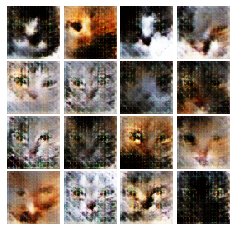


Iter: 5750, D: 0.2143, G:0.3246


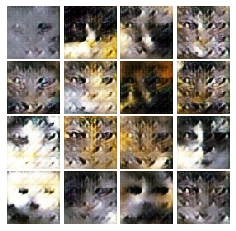


EPOCH:  13
Iter: 6000, D: 0.1429, G:0.3466


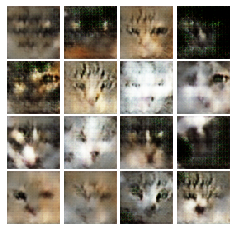


Iter: 6250, D: 0.283, G:0.5684


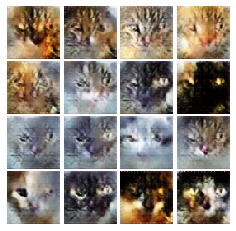


EPOCH:  14
Iter: 6500, D: 0.1253, G:0.2776


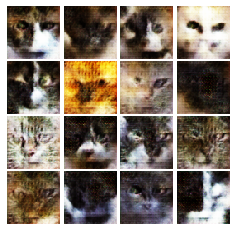


Iter: 6750, D: 0.3019, G:0.3729


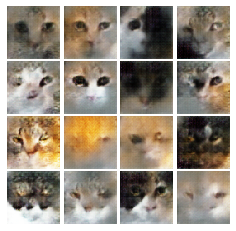


EPOCH:  15
Iter: 7000, D: 0.1876, G:0.2892


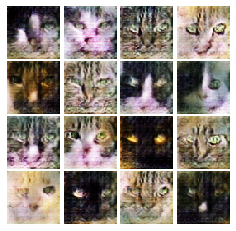


Iter: 7250, D: 0.1923, G:0.1989


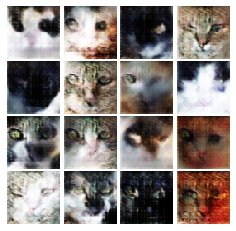


EPOCH:  16
Iter: 7500, D: 0.3622, G:0.1882


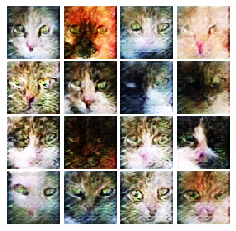


Iter: 7750, D: 0.3014, G:0.307


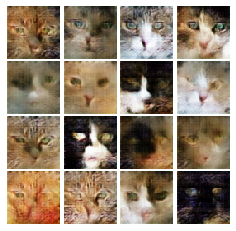


EPOCH:  17
Iter: 8000, D: 0.2102, G:0.1509


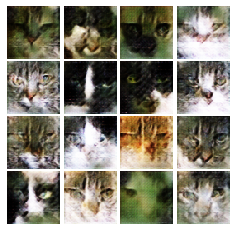


Iter: 8250, D: 0.2136, G:0.4068


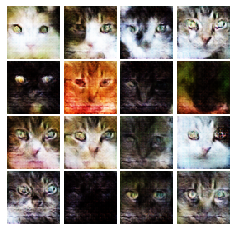


EPOCH:  18
Iter: 8500, D: 0.2131, G:0.2581


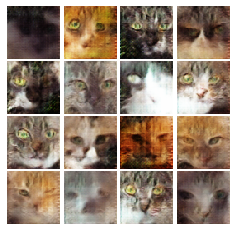


Iter: 8750, D: 0.2802, G:0.4919


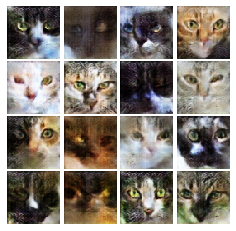


EPOCH:  19
Iter: 9000, D: 0.242, G:0.1767


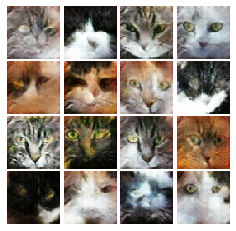


Iter: 9250, D: 0.2718, G:0.2872


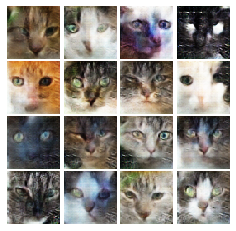


EPOCH:  20
Iter: 9500, D: 0.2054, G:0.3087


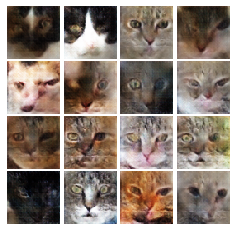


Iter: 9750, D: 0.2315, G:0.2969


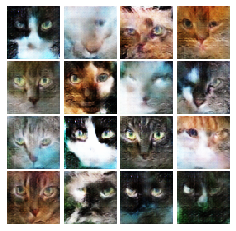


EPOCH:  21
Iter: 10000, D: 0.2259, G:0.4022


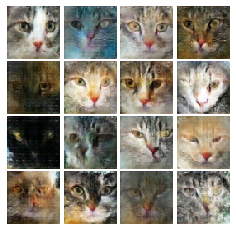


Iter: 10250, D: 0.2341, G:0.2307


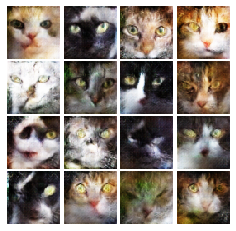


EPOCH:  22
Iter: 10500, D: 0.2021, G:0.3154


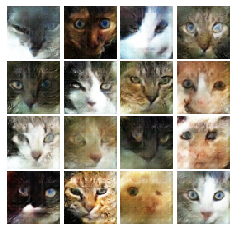


Iter: 10750, D: 0.1876, G:0.7135


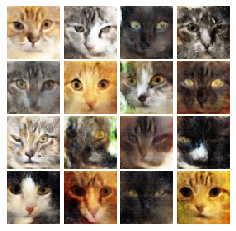


EPOCH:  23
Iter: 11000, D: 0.2799, G:0.249


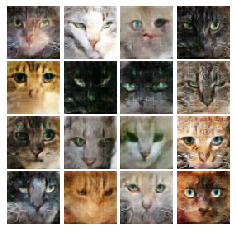


Iter: 11250, D: 0.131, G:0.3674


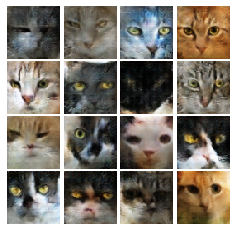


EPOCH:  24
Iter: 11500, D: 0.2073, G:0.3814


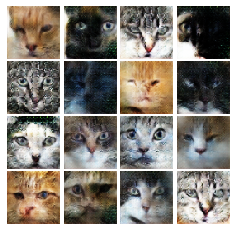


Iter: 11750, D: 0.2842, G:0.2556


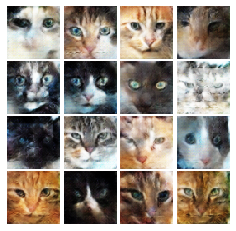


EPOCH:  25
Iter: 12000, D: 0.149, G:0.5083


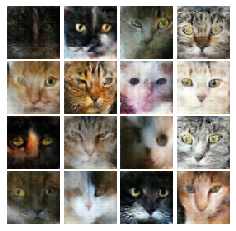


Iter: 12250, D: 0.1223, G:0.3438


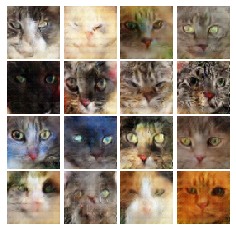


EPOCH:  26
Iter: 12500, D: 0.1869, G:0.224


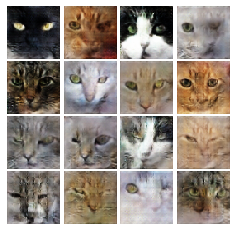


Iter: 12750, D: 0.4052, G:0.1442


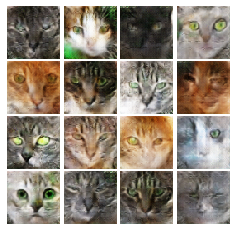


EPOCH:  27
Iter: 13000, D: 0.1761, G:0.2785


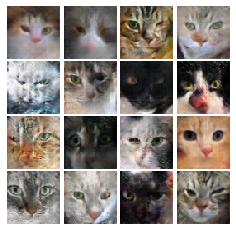


Iter: 13250, D: 0.1477, G:0.1485


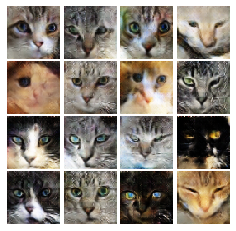


EPOCH:  28
Iter: 13500, D: 0.1643, G:0.3108


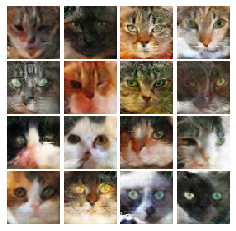


Iter: 13750, D: 0.1351, G:0.4889


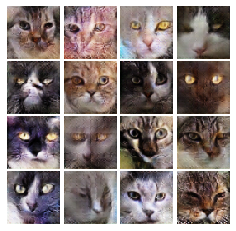


EPOCH:  29
Iter: 14000, D: 0.07447, G:0.339


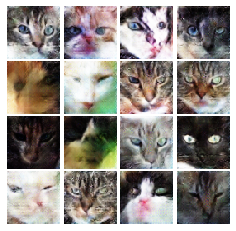


Iter: 14250, D: 0.117, G:0.4406


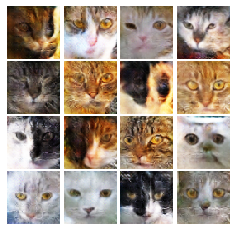


EPOCH:  30
Iter: 14500, D: 0.1963, G:0.5976


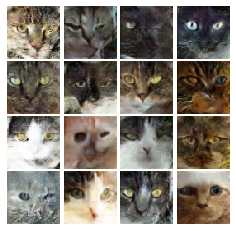


Iter: 14750, D: 0.1388, G:0.2898


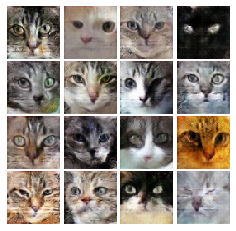


EPOCH:  31
Iter: 15000, D: 0.4106, G:0.1847


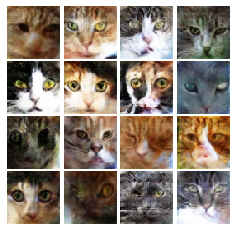


Iter: 15250, D: 0.1281, G:0.4374


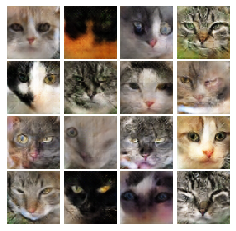


EPOCH:  32
Iter: 15500, D: 0.1752, G:0.3616


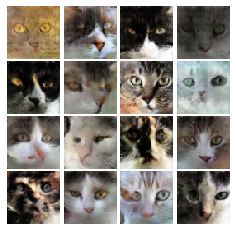


EPOCH:  33
Iter: 15750, D: 0.1121, G:0.5277


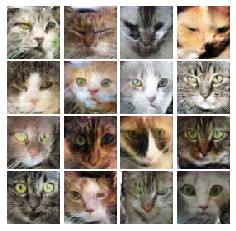


Iter: 16000, D: 0.1533, G:0.8683


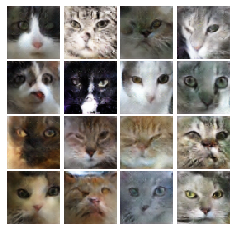


EPOCH:  34
Iter: 16250, D: 0.05495, G:0.4671


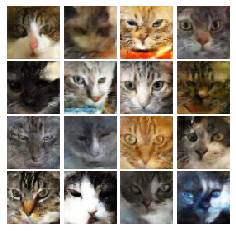


Iter: 16500, D: 0.09575, G:0.313


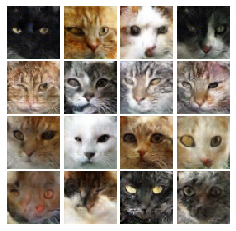


EPOCH:  35
Iter: 16750, D: 0.1784, G:0.2012


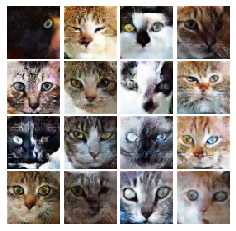


Iter: 17000, D: 0.3576, G:0.1541


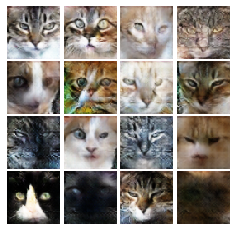


EPOCH:  36
Iter: 17250, D: 0.1954, G:0.1669


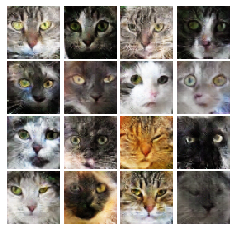


Iter: 17500, D: 0.05452, G:0.511


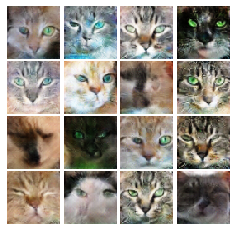


EPOCH:  37
Iter: 17750, D: 0.08473, G:0.4274


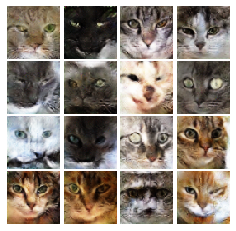


Iter: 18000, D: 0.0804, G:0.3716


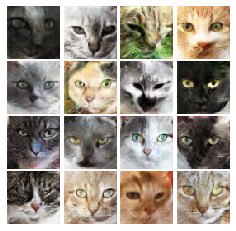


EPOCH:  38
Iter: 18250, D: 0.09309, G:0.3375


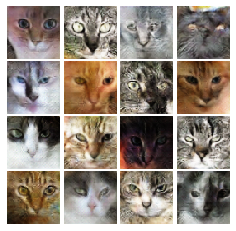


Iter: 18500, D: 0.08618, G:0.5128


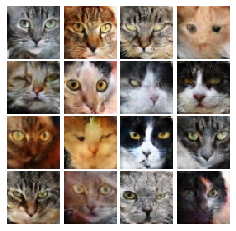


EPOCH:  39
Iter: 18750, D: 0.08077, G:0.3912


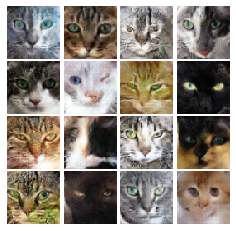


Iter: 19000, D: 0.2254, G:0.5746


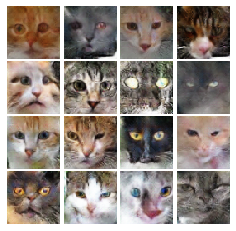


EPOCH:  40
Iter: 19250, D: 0.06582, G:0.6038


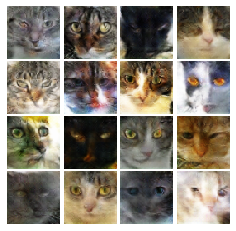


Iter: 19500, D: 0.1229, G:0.6148


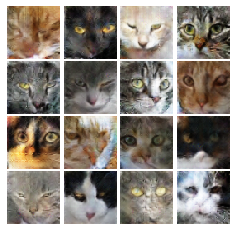


EPOCH:  41
Iter: 19750, D: 0.07797, G:0.4247


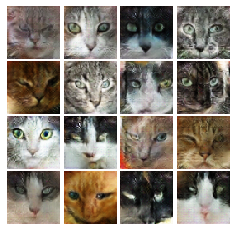


Iter: 20000, D: 0.09252, G:0.6554


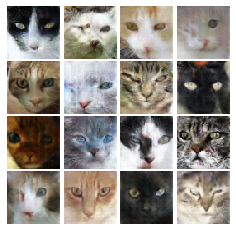


EPOCH:  42
Iter: 20250, D: 0.02419, G:0.5451


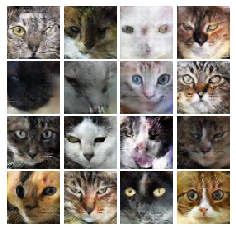


Iter: 20500, D: 0.07688, G:0.4916


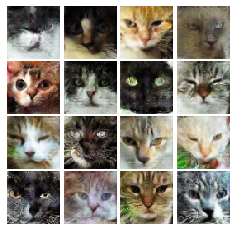


EPOCH:  43
Iter: 20750, D: 0.1295, G:0.5754


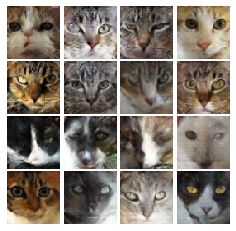


Iter: 21000, D: 0.1491, G:0.4179


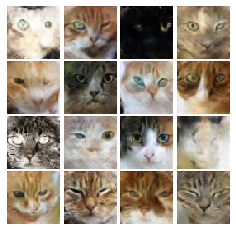


EPOCH:  44
Iter: 21250, D: 0.08035, G:0.3925


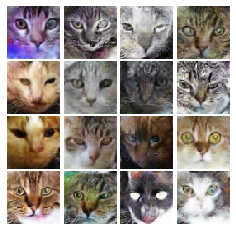


Iter: 21500, D: 0.02281, G:0.5975


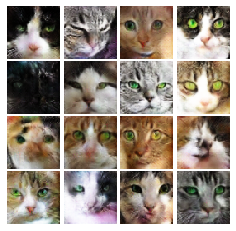


EPOCH:  45
Iter: 21750, D: 0.08445, G:0.3761


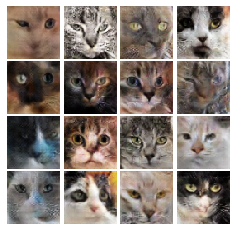


Iter: 22000, D: 0.07179, G:0.8319


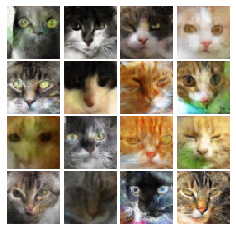


EPOCH:  46
Iter: 22250, D: 0.0568, G:0.3484


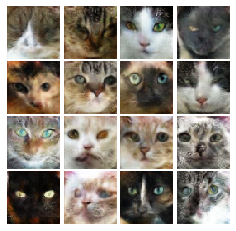


Iter: 22500, D: 0.04299, G:0.6211


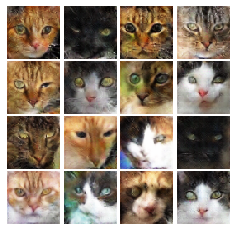


EPOCH:  47
Iter: 22750, D: 0.1146, G:0.5569


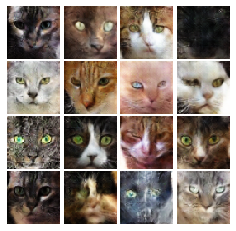


Iter: 23000, D: 0.04008, G:0.3931


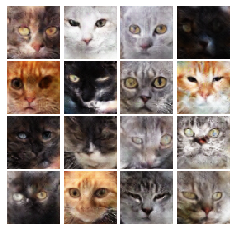


EPOCH:  48
Iter: 23250, D: 0.02141, G:0.6558


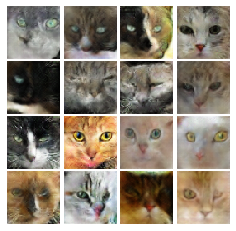


Iter: 23500, D: 0.08645, G:0.2403


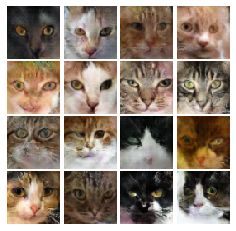


EPOCH:  49
Iter: 23750, D: 0.05237, G:0.6467


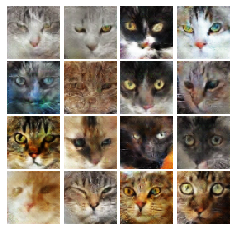


Iter: 24000, D: 0.05423, G:0.668


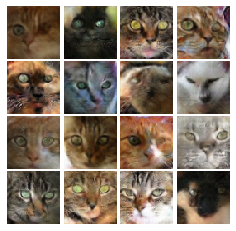


EPOCH:  50
Iter: 24250, D: 0.02501, G:0.4241


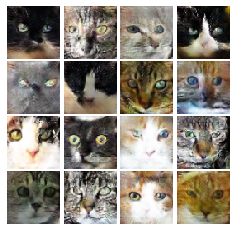


Iter: 24500, D: 0.04648, G:0.438


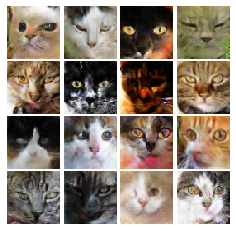

In [ ]:
# ls-gan
#  change the train() method a little bit to fit the input dimension. noise_size
train(D, G, D_optimizer, G_optimizer, ls_discriminator_loss, 
          ls_generator_loss, num_epochs=NUM_EPOCHS, show_every=250,
          batch_size=batch_size, train_loader=cat_loader_train, device=device)